<a href="https://colab.research.google.com/github/fifaak/BrainStroke_Segmentation/blob/main/SP_proj_ALL_IN_ONE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount("/content/drive")
!cp /content/drive/MyDrive/spdataset.zip /content/dataset.zip
!unzip /content/dataset.zip

Mounted at /content/drive
Archive:  /content/dataset.zip
   creating: spdataset/
   creating: spdataset/original/
  inflating: __MACOSX/spdataset/._original  
   creating: spdataset/mask/
  inflating: __MACOSX/spdataset/._mask  
  inflating: spdataset/original/63.jpg  
  inflating: __MACOSX/spdataset/original/._63.jpg  
  inflating: spdataset/original/189.jpg  
  inflating: __MACOSX/spdataset/original/._189.jpg  
  inflating: spdataset/original/77.jpg  
  inflating: __MACOSX/spdataset/original/._77.jpg  
  inflating: spdataset/original/162.jpg  
  inflating: __MACOSX/spdataset/original/._162.jpg  
  inflating: spdataset/original/176.jpg  
  inflating: __MACOSX/spdataset/original/._176.jpg  
  inflating: spdataset/original/88.jpg  
  inflating: __MACOSX/spdataset/original/._88.jpg  
  inflating: spdataset/original/348.jpg  
  inflating: __MACOSX/spdataset/original/._348.jpg  
  inflating: spdataset/original/228.jpg  
  inflating: __MACOSX/spdataset/original/._228.jpg  
  inflating: spda

In [ ]:
spdataset
├── mask
│   ├── 100_HGE_Seg.jpg
│   ├── 101_HGE_Seg.jpg
│   ├── 102_HGE_Seg.jpg
│   ├── ...
└── original
    ├── 100.jpg
    ├── 101.jpg
    ├── 102.jpg
    ├── ...

each image is grey scale and 650 × 650 pixels

In [2]:
!pip install torch torchvision segmentation-models-pytorch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 1.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [25]:
model.eval()
with torch.no_grad():
    for images, masks in dataloader:
        images = images.to(device)
        outputs = model(images)
        probs = torch.sigmoid(outputs)
        print(probs.mean(), probs.min(), probs.max())
        break


tensor(0.2012, device='cuda:0') tensor(2.1372e-06, device='cuda:0') tensor(1., device='cuda:0')


## Optimize scale

In [5]:
import os
from torch.utils.data import random_split, DataLoader, Dataset
import torch.nn.functional as F
import segmentation_models_pytorch as smp
import torch.optim as optim
import torch
import torch.nn as nn
import numpy as np
from torchvision import transforms
from PIL import Image
from torch.utils.tensorboard import SummaryWriter
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, jaccard_score
import torchvision

# Define paths
image_dir = '/content/spdataset/original'
mask_dir = '/content/spdataset/mask'

# Dataset class
class BrainStrokeDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        image = Image.open(os.path.join(self.image_dir, img_name)).convert("L")
        mask = Image.open(os.path.join(self.mask_dir, img_name.split('.')[0] + '_HGE_Seg.jpg')).convert("L")

        # Resize images and masks to 256x256
        image = image.resize((256, 256))
        mask = mask.resize((256, 256))

        # Convert images and masks to tensors
        image = transforms.ToTensor()(image)
        mask = transforms.ToTensor()(mask)

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        # Convert mask to binary
        mask = mask > 0.5
        mask = mask.float()

        return image, mask

# Transformations
transform = transforms.Compose([
    transforms.Normalize(mean=[0.5], std=[0.5])
])

# Dataset
dataset = BrainStrokeDataset(image_dir=image_dir, mask_dir=mask_dir, transform=transform)

# Dataset sizes
dataset_size = len(dataset)
train_size = int(0.7 * dataset_size)
valid_size = int(0.1 * dataset_size)
test_size = dataset_size - train_size - valid_size

# Splits
train_dataset, valid_dataset, test_dataset = random_split(dataset, [train_size, valid_size, test_size])

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

# Model
model = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=1,
    classes=1,
)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Loss and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

# TensorBoard SummaryWriter
writer = SummaryWriter()

# Adding model graph
images, _ = next(iter(train_loader))  # Get a batch of images to visualize the model graph
images = images.to(device)
writer.add_graph(model, images)

def train_one_epoch(model, criterion, optimizer, data_loader, device):
    model.train()
    total_loss = 0
    total_iou = 0
    total_dice = 0
    total_accuracy = 0
    total_precision = 0
    total_recall = 0
    total_f1 = 0

    for images, masks in data_loader:
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks)

        if torch.isnan(loss) or torch.isinf(loss):
            print(f"NaN or Inf detected in loss")
            continue

        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        preds = torch.sigmoid(outputs)
        preds = (preds > 0.5).float()

        iou = jaccard_score(masks.flatten().cpu(), preds.flatten().cpu())
        dice = f1_score(masks.flatten().cpu(), preds.flatten().cpu())
        accuracy = accuracy_score(masks.flatten().cpu(), preds.flatten().cpu())
        precision = precision_score(masks.flatten().cpu(), preds.flatten().cpu(), zero_division=0)
        recall = recall_score(masks.flatten().cpu(), preds.flatten().cpu(), zero_division=0)
        f1 = f1_score(masks.flatten().cpu(), preds.flatten().cpu())

        total_iou += iou
        total_dice += dice
        total_accuracy += accuracy
        total_precision += precision
        total_recall += recall
        total_f1 += f1

    avg_loss = total_loss / len(data_loader)
    avg_iou = total_iou / len(data_loader)
    avg_dice = total_dice / len(data_loader)
    avg_accuracy = total_accuracy / len(data_loader)
    avg_precision = total_precision / len(data_loader)
    avg_recall = total_recall / len(data_loader)
    avg_f1 = total_f1 / len(data_loader)

    return avg_loss, avg_iou, avg_dice, avg_accuracy, avg_precision, avg_recall, avg_f1

def validate_one_epoch(model, criterion, data_loader, device):
    model.eval()
    total_loss = 0
    total_iou = 0
    total_dice = 0
    total_accuracy = 0
    total_precision = 0
    total_recall = 0
    total_f1 = 0

    with torch.no_grad():
        for images, masks in data_loader:
            images = images.to(device)
            masks = masks.to(device)
            outputs = model(images)
            loss = criterion(outputs, masks)
            total_loss += loss.item()

            preds = torch.sigmoid(outputs)
            preds = (preds > 0.5).float()

            iou = jaccard_score(masks.flatten().cpu(), preds.flatten().cpu())
            dice = f1_score(masks.flatten().cpu(), preds.flatten().cpu())
            accuracy = accuracy_score(masks.flatten().cpu(), preds.flatten().cpu())
            precision = precision_score(masks.flatten().cpu(), preds.flatten().cpu(), zero_division=0)
            recall = recall_score(masks.flatten().cpu(), preds.flatten().cpu(), zero_division=0)
            f1 = f1_score(masks.flatten().cpu(), preds.flatten().cpu())

            total_iou += iou
            total_dice += dice
            total_accuracy += accuracy
            total_precision += precision
            total_recall += recall
            total_f1 += f1

    avg_loss = total_loss / len(data_loader)
    avg_iou = total_iou / len(data_loader)
    avg_dice = total_dice / len(data_loader)
    avg_accuracy = total_accuracy / len(data_loader)
    avg_precision = total_precision / len(data_loader)
    avg_recall = total_recall / len(data_loader)
    avg_f1 = total_f1 / len(data_loader)

    return avg_loss, avg_iou, avg_dice, avg_accuracy, avg_precision, avg_recall, avg_f1

# Training loop with validation
num_epochs = 3
for epoch in range(num_epochs):
    train_loss, train_iou, train_dice, train_accuracy, train_precision, train_recall, train_f1 = train_one_epoch(model, criterion, optimizer, train_loader, device)
    valid_loss, valid_iou, valid_dice, valid_accuracy, valid_precision, valid_recall, valid_f1 = validate_one_epoch(model, criterion, valid_loader, device)

    print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Valid Loss: {valid_loss:.4f}, Train IoU: {train_iou:.4f}, Valid IoU: {valid_iou:.4f}, Train Dice: {train_dice:.4f}, Valid Dice: {valid_dice:.4f}, Train Accuracy: {train_accuracy:.4f}, Valid Accuracy: {valid_accuracy:.4f}, Train Precision: {train_precision:.4f}, Valid Precision: {valid_precision:.4f}, Train Recall: {train_recall:.4f}, Valid Recall: {valid_recall:.4f}, Train F1: {train_f1:.4f}, Valid F1: {valid_f1:.4f}")

    # Logging to TensorBoard
    writer.add_scalar('Loss/Train', train_loss, epoch)
    writer.add_scalar('Loss/Validation', valid_loss, epoch)
    writer.add_scalar('IoU/Train', train_iou, epoch)
    writer.add_scalar('IoU/Validation', valid_iou, epoch)
    writer.add_scalar('Dice/Train', train_dice, epoch)
    writer.add_scalar('Dice/Validation', valid_dice, epoch)
    writer.add_scalar('Accuracy/Train', train_accuracy, epoch)
    writer.add_scalar('Accuracy/Validation', valid_accuracy, epoch)
    writer.add_scalar('Precision/Train', train_precision, epoch)
    writer.add_scalar('Precision/Validation', valid_precision, epoch)
    writer.add_scalar('Recall/Train', train_recall, epoch)
    writer.add_scalar('Recall/Validation', valid_recall, epoch)
    writer.add_scalar('F1/Train', train_f1, epoch)
    writer.add_scalar('F1/Validation', valid_f1, epoch)

    # Adding sample images to TensorBoard every 5 epochs
    if epoch % 5 == 0:
        writer.add_image('Images/Original', torchvision.utils.make_grid(images), epoch)
        writer.add_image('Images/Mask', torchvision.utils.make_grid(masks), epoch)
        writer.add_image('Images/Prediction', torchvision.utils.make_grid(preds), epoch)

    # Adding histograms of model parameters
    for name, param in model.named_parameters():
        writer.add_histogram(name, param, epoch)

# Close the writer
writer.close()


/usr/local/lib/python3.10/dist-packages/segmentation_models_pytorch/base/model.py:16: TracerWarning: Converting a tensor to a Python boolean might cause the trace to be incorrect. We can't record the data flow of Python values, so this value will be treated as a constant in the future. This means that the trace might not generalize to other inputs!
  if h % output_stride != 0 or w % output_stride != 0:


Epoch 1/3, Train Loss: 0.8126, Valid Loss: 1.1908, Train IoU: 0.0055, Valid IoU: 0.0036, Train Dice: 0.0108, Valid Dice: 0.0072, Train Accuracy: 0.2929, Valid Accuracy: 0.4527, Train Precision: 0.0055, Valid Precision: 0.0036, Train Recall: 0.6129, Valid Recall: 0.4129, Train F1: 0.0108, Valid F1: 0.0072
Epoch 2/3, Train Loss: 0.6259, Valid Loss: 0.6297, Train IoU: 0.0007, Valid IoU: 0.0001, Train Dice: 0.0013, Valid Dice: 0.0001, Train Accuracy: 0.6215, Valid Accuracy: 0.7883, Train Precision: 0.0007, Valid Precision: 0.0001, Train Recall: 0.0465, Valid Recall: 0.0034, Train F1: 0.0013, Valid F1: 0.0001
Epoch 3/3, Train Loss: 0.5593, Valid Loss: 0.5917, Train IoU: 0.0000, Valid IoU: 0.0000, Train Dice: 0.0000, Valid Dice: 0.0000, Train Accuracy: 0.8956, Valid Accuracy: 0.9312, Train Precision: 0.0000, Valid Precision: 0.0000, Train Recall: 0.0003, Valid Recall: 0.0000, Train F1: 0.0000, Valid F1: 0.0000


In [1]:
%reload_ext tensorboard

In [6]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

In [4]:
# IoU calculation function
def calculate_iou(pred, target, threshold=0.5):
    pred = pred > threshold
    target = target > threshold

    intersection = (pred & target).sum((1, 2))
    union = (pred | target).sum((1, 2))

    # Debugging information
    if torch.any(union == 0):
        print("Union is zero for some images")

    # Avoid division by zero
    iou = torch.where(union == 0, torch.tensor(float('nan')), intersection / union)
    return iou[~torch.isnan(iou)].mean()  # Ignore NaN values in mean calculation

# Model evaluation with IoU metric
model.eval()
test_loss = 0
ious = []

with torch.no_grad():
    for images, masks in test_loader:
        images = images.to(device)
        masks = masks.to(device)
        outputs = model(images)

        loss = criterion(outputs, masks)
        test_loss += loss.item()

        # Convert outputs to probabilities
        probs = torch.sigmoid(outputs)

        # Calculate IoU
        iou = calculate_iou(probs.cpu(), masks.cpu())
        print(f"IoU for current batch: {iou.item() if not torch.isnan(iou) else 'NaN'}")
        if not torch.isnan(iou):
            ious.append(iou.item())

test_loss /= len(test_loader)
mean_iou = np.nanmean(ious)  # Use np.nanmean to ignore NaN values

print(f"Test Loss: {test_loss:.4f}")
print(f"Mean IoU: {mean_iou:.4f}")

Union is zero for some images
IoU for current batch: 0.03472523018717766
Union is zero for some images
IoU for current batch: 0.0017615314573049545
Union is zero for some images
IoU for current batch: 0.0
Union is zero for some images
IoU for current batch: 0.0
Union is zero for some images
IoU for current batch: 0.021535778418183327
Union is zero for some images
IoU for current batch: 0.0025696889497339725
Union is zero for some images
IoU for current batch: 0.014715904369950294
Union is zero for some images
IoU for current batch: 0.0
Union is zero for some images
IoU for current batch: 0.0
Union is zero for some images
IoU for current batch: 0.008405526168644428
Union is zero for some images
IoU for current batch: 0.0
Union is zero for some images
IoU for current batch: 0.03926456347107887
Union is zero for some images
IoU for current batch: 0.02700946480035782
Union is zero for some images
IoU for current batch: 0.0284222811460495
Union is zero for some images
IoU for current batch:

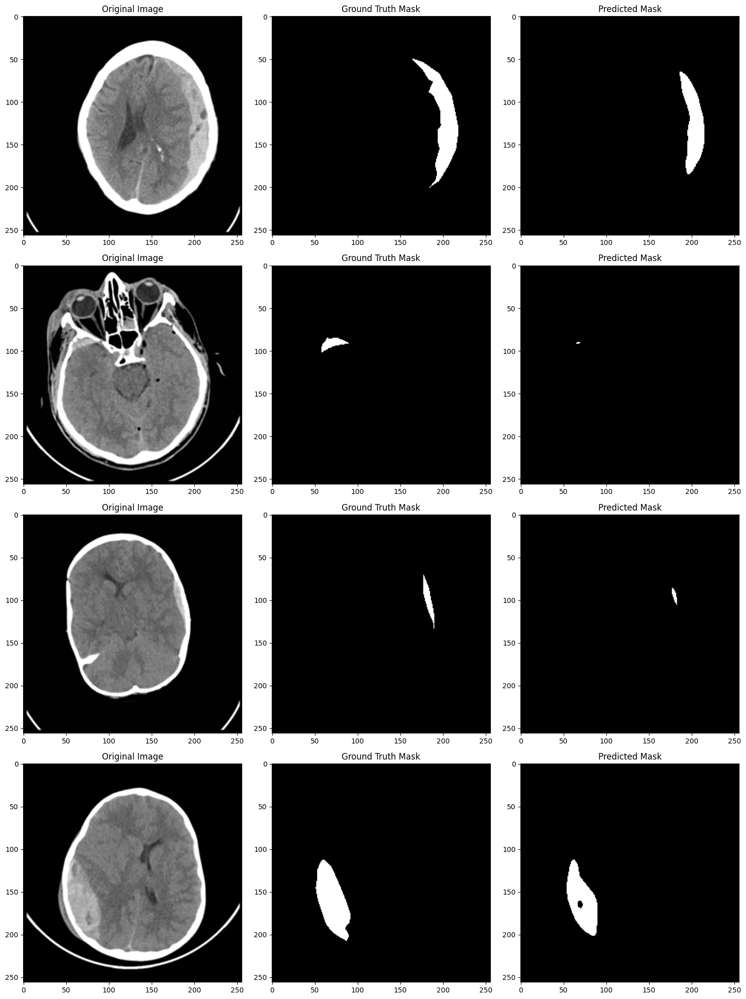

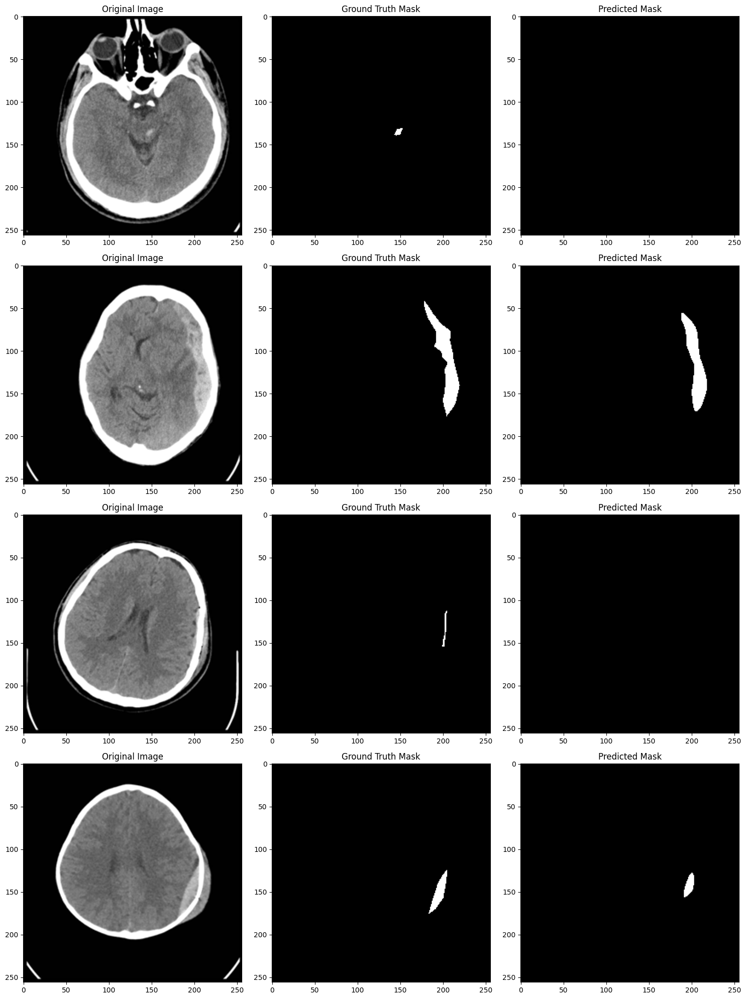

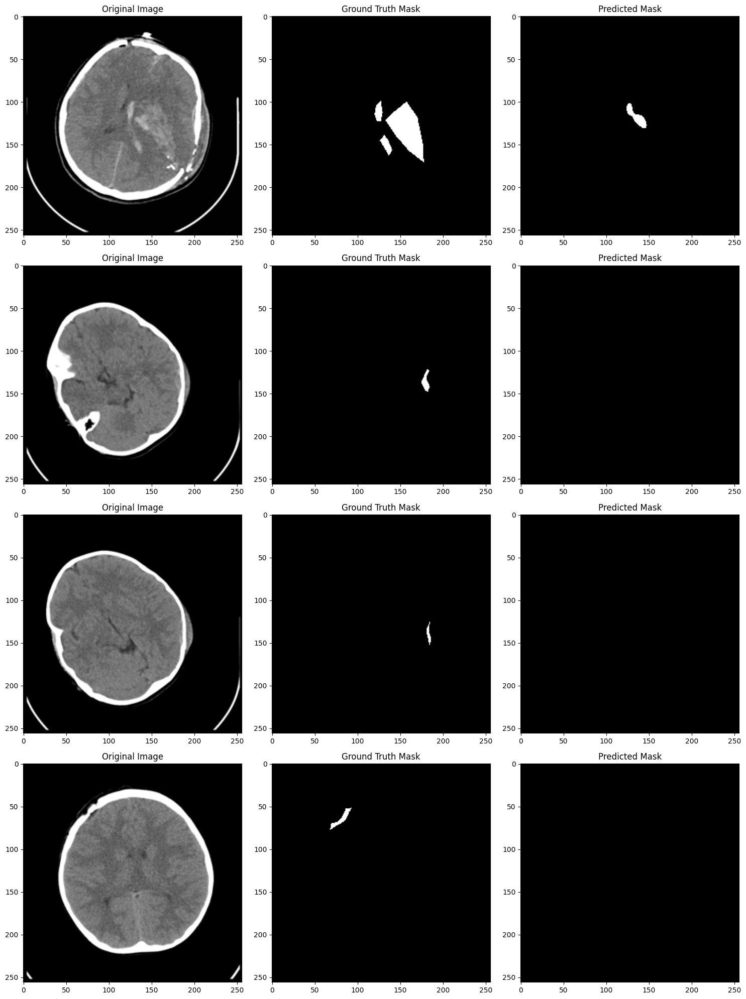

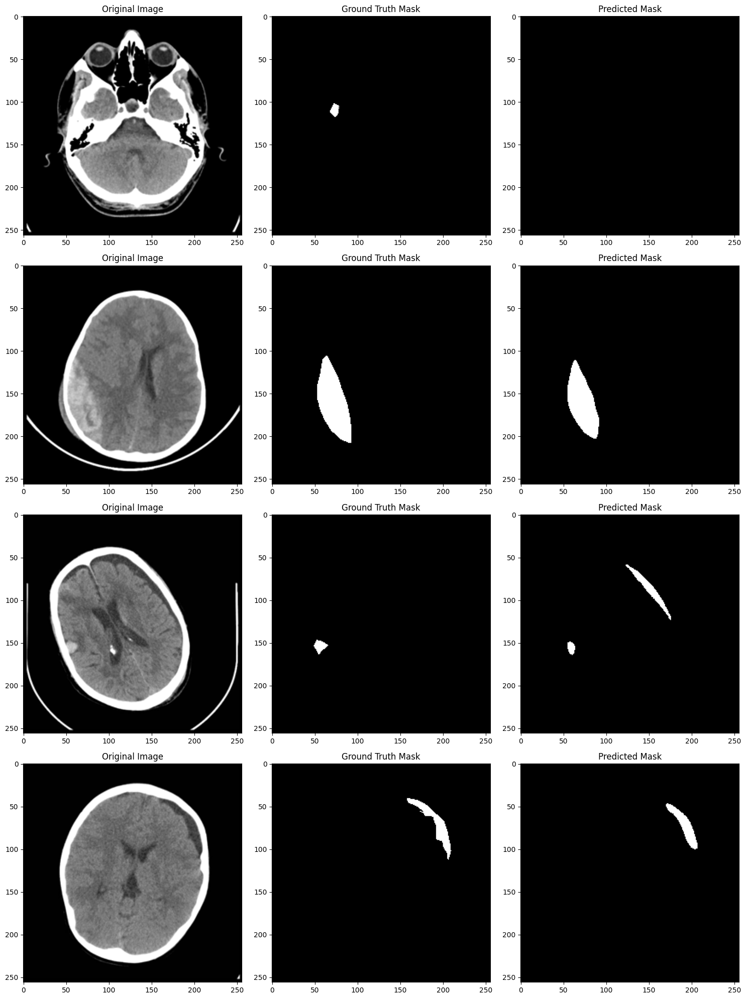

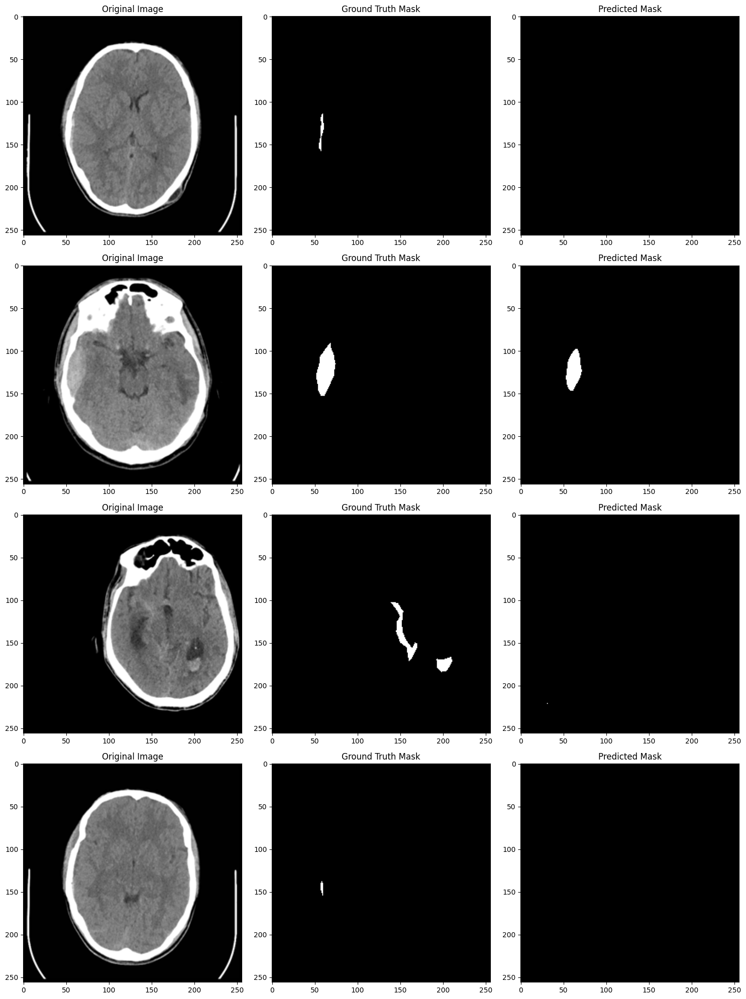

...

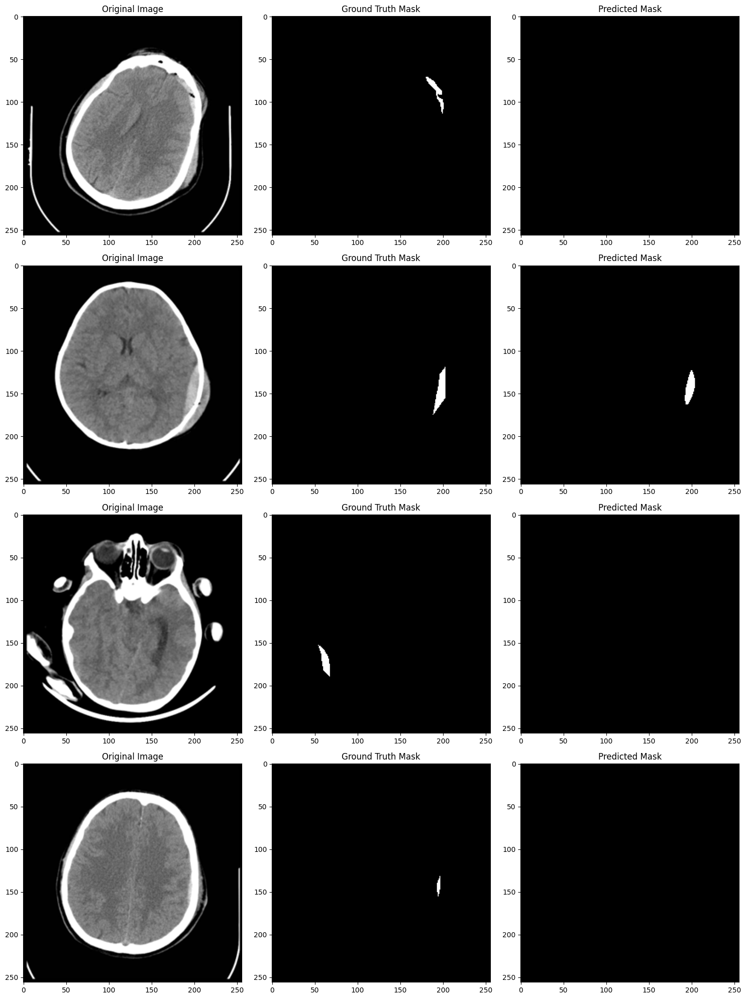

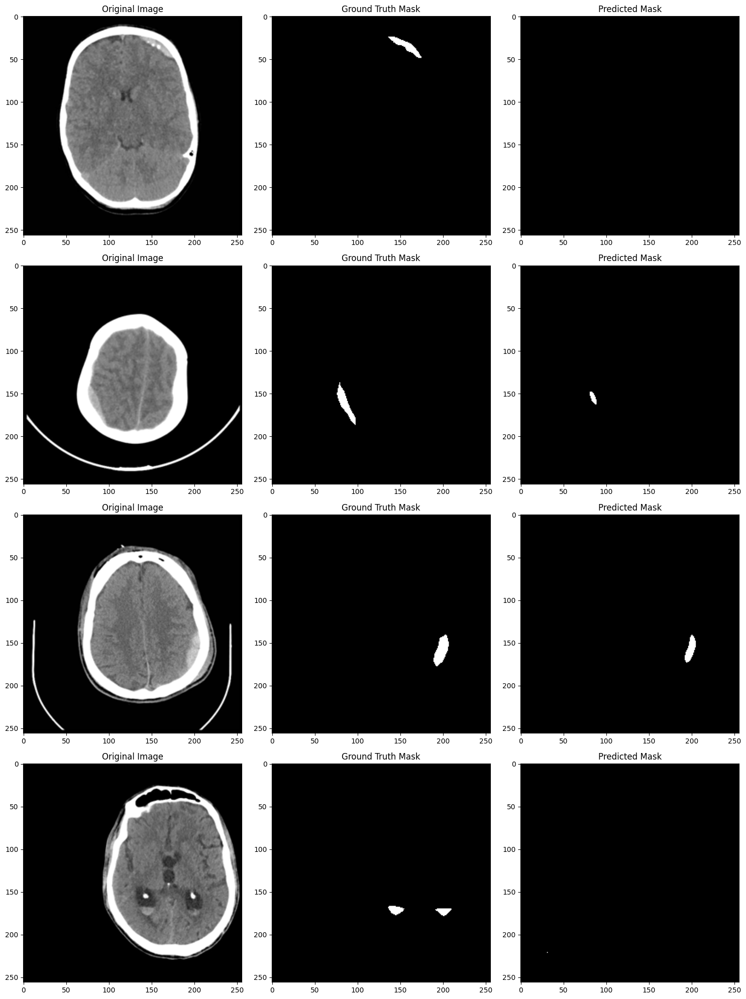

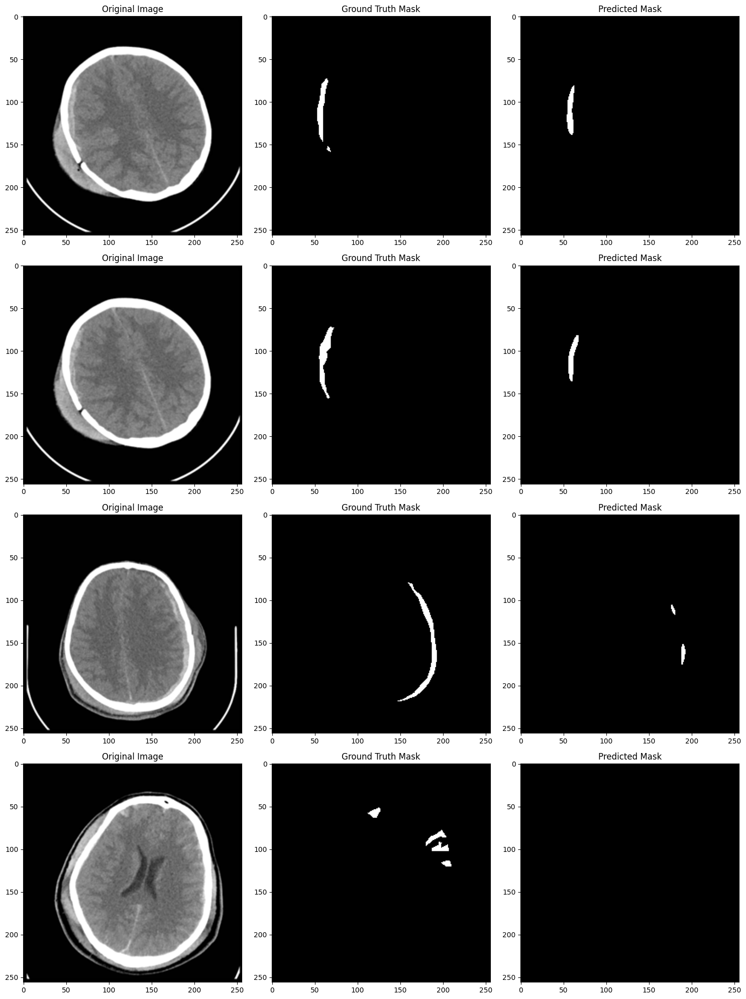

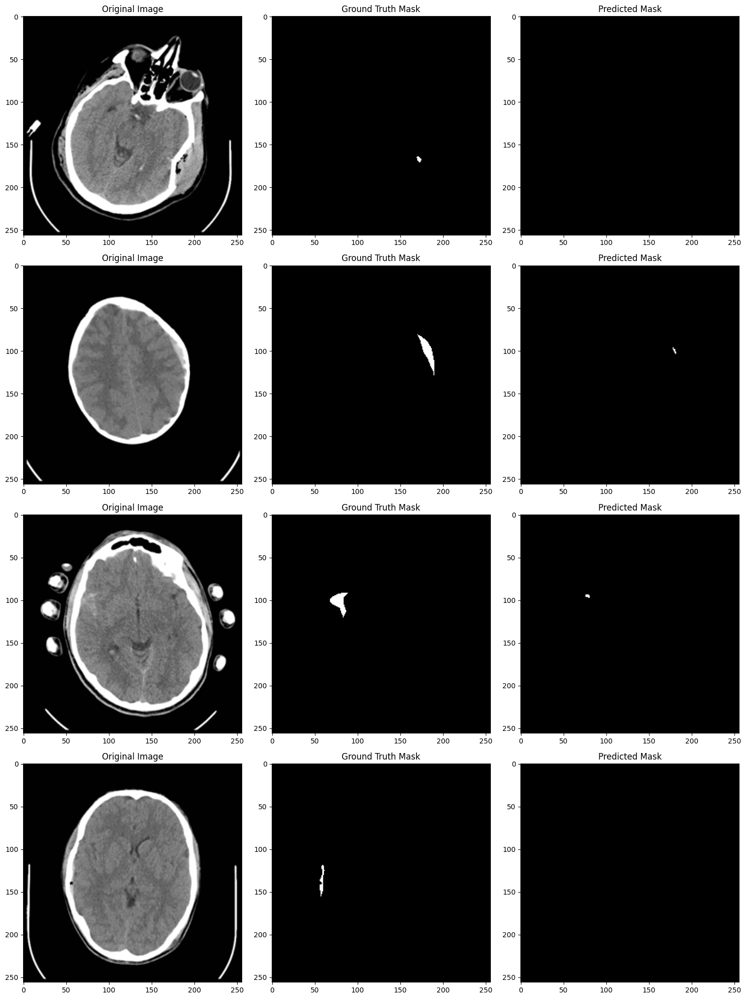

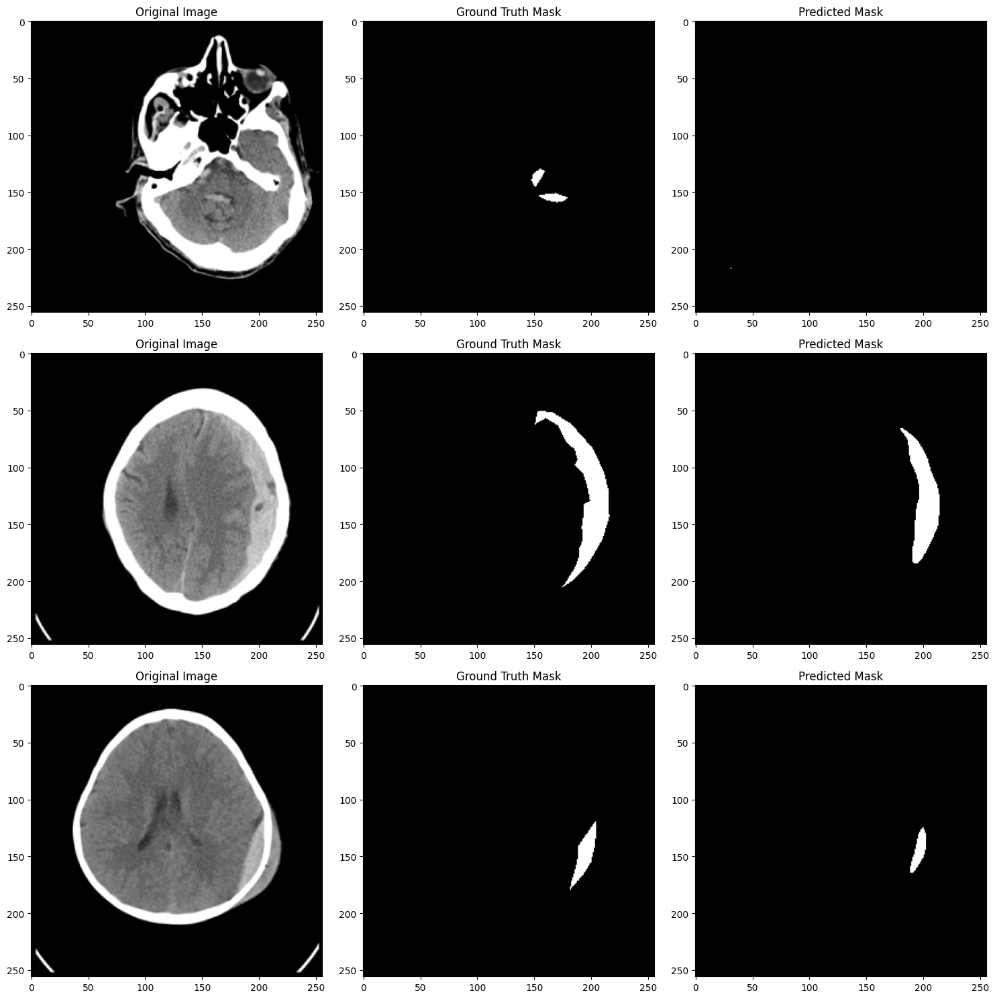

In [47]:
import matplotlib.pyplot as plt

def visualize_segmentation(images, masks, preds, num_images=4):
    images = images.cpu().numpy()
    masks = masks.cpu().numpy()
    preds = preds.cpu().numpy()

    fig, axes = plt.subplots(num_images, 3, figsize=(15, num_images * 5))
    for i in range(num_images):
        axes[i, 0].imshow(images[i][0], cmap='gray')
        axes[i, 0].set_title('Original Image')

        axes[i, 1].imshow(masks[i][0], cmap='gray')
        axes[i, 1].set_title('Ground Truth Mask')

        axes[i, 2].imshow(preds[i][0], cmap='gray')
        axes[i, 2].set_title('Predicted Mask')

    plt.tight_layout()
    plt.show()

# Predict on test set
model.eval()
with torch.no_grad():
    for images, masks in test_loader:
        images = images.to(device)
        masks = masks.to(device)
        outputs = model(images)
        probs = torch.sigmoid(outputs)
        preds = (probs > 0.5).float()

        visualize_segmentation(images, masks, preds, num_images=len(images))


In [ ]:
# Save the entire model
torch.save(model, '/content/drive/MyDrive/SP_project/unet_model_resnet34andimagenet_best.pth')
torch.save(model.state_dict(), '/content/drive/MyDrive/SP_project/unet_model_statedict_resnet34andimagenet_best.pth')


### Backup Tensorboard

In [2]:
!pip install tensorboard


In [2]:
import csv

raw_data = """
Epoch 1/50, Train Loss: 0.6471, Valid Loss: 0.5420, Train IoU: 0.0201, Valid IoU: 0.0290, Train Dice: 0.0390, Valid Dice: 0.0560, Train Accuracy: 0.7318, Valid Accuracy: 0.8763, Train Precision: 0.0205, Valid Precision: 0.0297, Train Recall: 0.5834, Valid Recall: 0.5231, Train F1: 0.0390, Valid F1: 0.0560
Epoch 2/50, Train Loss: 0.4862, Valid Loss: 0.4617, Train IoU: 0.0767, Valid IoU: 0.0644, Train Dice: 0.1352, Valid Dice: 0.1150, Train Accuracy: 0.9564, Valid Accuracy: 0.9698, Train Precision: 0.0868, Valid Precision: 0.0727, Train Recall: 0.3716, Valid Recall: 0.2844, Train F1: 0.1352, Valid F1: 0.1150
Epoch 3/50, Train Loss: 0.4054, Valid Loss: 0.4373, Train IoU: 0.1435, Valid IoU: 0.0608, Train Dice: 0.2317, Valid Dice: 0.1097, Train Accuracy: 0.9874, Valid Accuracy: 0.9766, Train Precision: 0.2157, Valid Precision: 0.0757, Train Recall: 0.2693, Valid Recall: 0.2089, Train F1: 0.2317, Valid F1: 0.1097
Epoch 4/50, Train Loss: 0.3560, Valid Loss: 0.3596, Train IoU: 0.1693, Valid IoU: 0.1058, Train Dice: 0.2678, Valid Dice: 0.1800, Train Accuracy: 0.9910, Valid Accuracy: 0.9870, Train Precision: 0.3361, Valid Precision: 0.1602, Train Recall: 0.2398, Valid Recall: 0.2431, Train F1: 0.2678, Valid F1: 0.1800
Epoch 5/50, Train Loss: 0.3168, Valid Loss: 0.3089, Train IoU: 0.1854, Valid IoU: 0.1451, Train Dice: 0.2871, Valid Dice: 0.2346, Train Accuracy: 0.9921, Valid Accuracy: 0.9905, Train Precision: 0.3747, Valid Precision: 0.3103, Train Recall: 0.2457, Valid Recall: 0.2410, Train F1: 0.2871, Valid F1: 0.2346
Epoch 6/50, Train Loss: 0.2786, Valid Loss: 0.2688, Train IoU: 0.2288, Valid IoU: 0.1556, Train Dice: 0.3459, Valid Dice: 0.2343, Train Accuracy: 0.9932, Valid Accuracy: 0.9924, Train Precision: 0.4771, Valid Precision: 0.2549, Train Recall: 0.2820, Valid Recall: 0.2232, Train F1: 0.3459, Valid F1: 0.2343
Epoch 7/50, Train Loss: 0.2480, Valid Loss: 0.2411, Train IoU: 0.2906, Valid IoU: 0.2135, Train Dice: 0.4226, Valid Dice: 0.3194, Train Accuracy: 0.9941, Valid Accuracy: 0.9929, Train Precision: 0.5517, Valid Precision: 0.5131, Train Recall: 0.3578, Valid Recall: 0.3137, Train F1: 0.4226, Valid F1: 0.3194
Epoch 8/50, Train Loss: 0.2230, Valid Loss: 0.2136, Train IoU: 0.3076, Valid IoU: 0.2898, Train Dice: 0.4474, Valid Dice: 0.4284, Train Accuracy: 0.9940, Valid Accuracy: 0.9942, Train Precision: 0.5761, Valid Precision: 0.6073, Train Recall: 0.3926, Valid Recall: 0.3683, Train F1: 0.4474, Valid F1: 0.4284
Epoch 9/50, Train Loss: 0.2012, Valid Loss: 0.1969, Train IoU: 0.3479, Valid IoU: 0.2868, Train Dice: 0.4902, Valid Dice: 0.4183, Train Accuracy: 0.9948, Valid Accuracy: 0.9943, Train Precision: 0.6217, Valid Precision: 0.6046, Train Recall: 0.4187, Valid Recall: 0.3611, Train F1: 0.4902, Valid F1: 0.4183
Epoch 10/50, Train Loss: 0.1825, Valid Loss: 0.1805, Train IoU: 0.4017, Valid IoU: 0.3093, Train Dice: 0.5506, Valid Dice: 0.4473, Train Accuracy: 0.9953, Valid Accuracy: 0.9941, Train Precision: 0.6567, Valid Precision: 0.6367, Train Recall: 0.4832, Valid Recall: 0.4135, Train F1: 0.5506, Valid F1: 0.4473
Epoch 11/50, Train Loss: 0.1681, Valid Loss: 0.1668, Train IoU: 0.4132, Valid IoU: 0.3484, Train Dice: 0.5586, Valid Dice: 0.4927, Train Accuracy: 0.9953, Valid Accuracy: 0.9952, Train Precision: 0.6550, Valid Precision: 0.7074, Train Recall: 0.5149, Valid Recall: 0.4117, Train F1: 0.5586, Valid F1: 0.4927
Epoch 12/50, Train Loss: 0.1555, Valid Loss: 0.1508, Train IoU: 0.4181, Valid IoU: 0.3441, Train Dice: 0.5676, Valid Dice: 0.4867, Train Accuracy: 0.9954, Valid Accuracy: 0.9953, Train Precision: 0.6715, Valid Precision: 0.7305, Train Recall: 0.5007, Valid Recall: 0.4002, Train F1: 0.5676, Valid F1: 0.4867
Epoch 13/50, Train Loss: 0.1415, Valid Loss: 0.1394, Train IoU: 0.4407, Valid IoU: 0.3874, Train Dice: 0.5895, Valid Dice: 0.5453, Train Accuracy: 0.9958, Valid Accuracy: 0.9944, Train Precision: 0.6956, Valid Precision: 0.5542, Train Recall: 0.5289, Valid Recall: 0.5521, Train F1: 0.5895, Valid F1: 0.5453
Epoch 14/50, Train Loss: 0.1297, Valid Loss: 0.1259, Train IoU: 0.4955, Valid IoU: 0.4257, Train Dice: 0.6472, Valid Dice: 0.5814, Train Accuracy: 0.9959, Valid Accuracy: 0.9957, Train Precision: 0.7396, Valid Precision: 0.7296, Train Recall: 0.5870, Valid Recall: 0.4980, Train F1: 0.6472, Valid F1: 0.5814
Epoch 15/50, Train Loss: 0.1195, Valid Loss: 0.1169, Train IoU: 0.5290, Valid IoU: 0.5346, Train Dice: 0.6803, Valid Dice: 0.6923, Train Accuracy: 0.9963, Valid Accuracy: 0.9961, Train Precision: 0.7403, Valid Precision: 0.6964, Train Recall: 0.6394, Valid Recall: 0.6940, Train F1: 0.6803, Valid F1: 0.6923
Epoch 16/50, Train Loss: 0.1108, Valid Loss: 0.1093, Train IoU: 0.5511, Valid IoU: 0.5276, Train Dice: 0.7020, Valid Dice: 0.6859, Train Accuracy: 0.9965, Valid Accuracy: 0.9962, Train Precision: 0.7497, Valid Precision: 0.7275, Train Recall: 0.6676, Valid Recall: 0.6632, Train F1: 0.7020, Valid F1: 0.6859
Epoch 17/50, Train Loss: 0.1026, Valid Loss: 0.1034, Train IoU: 0.5666, Valid IoU: 0.4236, Train Dice: 0.7154, Valid Dice: 0.5840, Train Accuracy: 0.9967, Valid Accuracy: 0.9949, Train Precision: 0.7571, Valid Precision: 0.6303, Train Recall: 0.6913, Valid Recall: 0.6011, Train F1: 0.7154, Valid F1: 0.5840
Epoch 18/50, Train Loss: 0.0949, Valid Loss: 0.0939, Train IoU: 0.6333, Valid IoU: 0.5729, Train Dice: 0.7708, Valid Dice: 0.7247, Train Accuracy: 0.9970, Valid Accuracy: 0.9965, Train Precision: 0.8085, Valid Precision: 0.7329, Train Recall: 0.7474, Valid Recall: 0.7257, Train F1: 0.7708, Valid F1: 0.7247
Epoch 19/50, Train Loss: 0.0880, Valid Loss: 0.0877, Train IoU: 0.6298, Valid IoU: 0.5750, Train Dice: 0.7609, Valid Dice: 0.7264, Train Accuracy: 0.9974, Valid Accuracy: 0.9966, Train Precision: 0.7964, Valid Precision: 0.7397, Train Recall: 0.7411, Valid Recall: 0.7212, Train F1: 0.7609, Valid F1: 0.7264
Epoch 20/50, Train Loss: 0.0818, Valid Loss: 0.0813, Train IoU: 0.6515, Valid IoU: 0.5784, Train Dice: 0.7730, Valid Dice: 0.7291, Train Accuracy: 0.9975, Valid Accuracy: 0.9968, Train Precision: 0.7827, Valid Precision: 0.7945, Train Recall: 0.7697, Valid Recall: 0.6847, Train F1: 0.7730, Valid F1: 0.7291
Epoch 21/50, Train Loss: 0.0766, Valid Loss: 0.0767, Train IoU: 0.6633, Valid IoU: 0.5902, Train Dice: 0.7890, Valid Dice: 0.7391, Train Accuracy: 0.9974, Valid Accuracy: 0.9966, Train Precision: 0.8099, Valid Precision: 0.7250, Train Recall: 0.7767, Valid Recall: 0.7567, Train F1: 0.7890, Valid F1: 0.7391
Epoch 22/50, Train Loss: 0.0717, Valid Loss: 0.0723, Train IoU: 0.6800, Valid IoU: 0.6029, Train Dice: 0.8059, Valid Dice: 0.7499, Train Accuracy: 0.9975, Valid Accuracy: 0.9967, Train Precision: 0.8166, Valid Precision: 0.7222, Train Recall: 0.7992, Valid Recall: 0.7827, Train F1: 0.8059, Valid F1: 0.7499
Epoch 23/50, Train Loss: 0.0672, Valid Loss: 0.0692, Train IoU: 0.6932, Valid IoU: 0.6011, Train Dice: 0.8140, Valid Dice: 0.7483, Train Accuracy: 0.9977, Valid Accuracy: 0.9966, Train Precision: 0.8304, Valid Precision: 0.7130, Train Recall: 0.8029, Valid Recall: 0.7903, Train F1: 0.8140, Valid F1: 0.7483
Epoch 24/50, Train Loss: 0.0636, Valid Loss: 0.0631, Train IoU: 0.6898, Valid IoU: 0.6172, Train Dice: 0.8131, Valid Dice: 0.7603, Train Accuracy: 0.9976, Valid Accuracy: 0.9971, Train Precision: 0.8225, Valid Precision: 0.8001, Train Recall: 0.8176, Valid Recall: 0.7297, Train F1: 0.8131, Valid F1: 0.7603
Epoch 25/50, Train Loss: 0.0596, Valid Loss: 0.0605, Train IoU: 0.7073, Valid IoU: 0.6034, Train Dice: 0.8255, Valid Dice: 0.7500, Train Accuracy: 0.9977, Valid Accuracy: 0.9968, Train Precision: 0.8412, Valid Precision: 0.7684, Train Recall: 0.8182, Valid Recall: 0.7447, Train F1: 0.8255, Valid F1: 0.7500
Epoch 26/50, Train Loss: 0.0567, Valid Loss: 0.0582, Train IoU: 0.6786, Valid IoU: 0.6066, Train Dice: 0.8025, Valid Dice: 0.7529, Train Accuracy: 0.9976, Valid Accuracy: 0.9968, Train Precision: 0.8351, Valid Precision: 0.7446, Train Recall: 0.7899, Valid Recall: 0.7670, Train F1: 0.8025, Valid F1: 0.7529
Epoch 27/50, Train Loss: 0.0531, Valid Loss: 0.0550, Train IoU: 0.7172, Valid IoU: 0.6285, Train Dice: 0.8319, Valid Dice: 0.7699, Train Accuracy: 0.9978, Valid Accuracy: 0.9970, Train Precision: 0.8309, Valid Precision: 0.7646, Train Recall: 0.8388, Valid Recall: 0.7785, Train F1: 0.8319, Valid F1: 0.7699
Epoch 28/50, Train Loss: 0.0500, Valid Loss: 0.0521, Train IoU: 0.7216, Valid IoU: 0.6357, Train Dice: 0.8350, Valid Dice: 0.7750, Train Accuracy: 0.9979, Valid Accuracy: 0.9969, Train Precision: 0.8446, Valid Precision: 0.7391, Train Recall: 0.8351, Valid Recall: 0.8152, Train F1: 0.8350, Valid F1: 0.7750
Epoch 29/50, Train Loss: 0.0476, Valid Loss: 0.0502, Train IoU: 0.7371, Valid IoU: 0.6218, Train Dice: 0.8458, Valid Dice: 0.7642, Train Accuracy: 0.9981, Valid Accuracy: 0.9971, Train Precision: 0.8403, Valid Precision: 0.8195, Train Recall: 0.8586, Valid Recall: 0.7206, Train F1: 0.8458, Valid F1: 0.7642
Epoch 30/50, Train Loss: 0.0468, Valid Loss: 0.0482, Train IoU: 0.6504, Valid IoU: 0.5365, Train Dice: 0.7788, Valid Dice: 0.6901, Train Accuracy: 0.9975, Valid Accuracy: 0.9966, Train Precision: 0.8087, Valid Precision: 0.8069, Train Recall: 0.7614, Valid Recall: 0.6163, Train F1: 0.7788, Valid F1: 0.6901
Epoch 31/50, Train Loss: 0.0444, Valid Loss: 0.0446, Train IoU: 0.6740, Valid IoU: 0.6062, Train Dice: 0.8001, Valid Dice: 0.7510, Train Accuracy: 0.9975, Valid Accuracy: 0.9969, Train Precision: 0.8208, Valid Precision: 0.7776, Train Recall: 0.7845, Valid Recall: 0.7277, Train F1: 0.8001, Valid F1: 0.7510
Epoch 32/50, Train Loss: 0.0413, Valid Loss: 0.0445, Train IoU: 0.7042, Valid IoU: 0.5813, Train Dice: 0.8184, Valid Dice: 0.7334, Train Accuracy: 0.9979, Valid Accuracy: 0.9963, Train Precision: 0.8367, Valid Precision: 0.6948, Train Recall: 0.8108, Valid Recall: 0.7851, Train F1: 0.8184, Valid F1: 0.7334
Epoch 33/50, Train Loss: 0.0390, Valid Loss: 0.0404, Train IoU: 0.7331, Valid IoU: 0.6459, Train Dice: 0.8420, Valid Dice: 0.7821, Train Accuracy: 0.9982, Valid Accuracy: 0.9973, Train Precision: 0.8474, Valid Precision: 0.8087, Train Recall: 0.8433, Valid Recall: 0.7589, Train F1: 0.8420, Valid F1: 0.7821
Epoch 34/50, Train Loss: 0.0369, Valid Loss: 0.0393, Train IoU: 0.7621, Valid IoU: 0.6138, Train Dice: 0.8626, Valid Dice: 0.7571, Train Accuracy: 0.9982, Valid Accuracy: 0.9972, Train Precision: 0.8627, Valid Precision: 0.8349, Train Recall: 0.8667, Valid Recall: 0.6995, Train F1: 0.8626, Valid F1: 0.7571
Epoch 35/50, Train Loss: 0.0356, Valid Loss: 0.0369, Train IoU: 0.7494, Valid IoU: 0.6449, Train Dice: 0.8540, Valid Dice: 0.7805, Train Accuracy: 0.9981, Valid Accuracy: 0.9973, Train Precision: 0.8559, Valid Precision: 0.8332, Train Recall: 0.8600, Valid Recall: 0.7389, Train F1: 0.8540, Valid F1: 0.7805
Epoch 36/50, Train Loss: 0.0337, Valid Loss: 0.0363, Train IoU: 0.7562, Valid IoU: 0.5940, Train Dice: 0.8563, Valid Dice: 0.7395, Train Accuracy: 0.9983, Valid Accuracy: 0.9971, Train Precision: 0.8422, Valid Precision: 0.8589, Train Recall: 0.8820, Valid Recall: 0.6574, Train F1: 0.8563, Valid F1: 0.7395
Epoch 37/50, Train Loss: 0.0320, Valid Loss: 0.0348, Train IoU: 0.7862, Valid IoU: 0.6157, Train Dice: 0.8786, Valid Dice: 0.7564, Train Accuracy: 0.9984, Valid Accuracy: 0.9972, Train Precision: 0.8777, Valid Precision: 0.8592, Train Recall: 0.8837, Valid Recall: 0.6908, Train F1: 0.8786, Valid F1: 0.7564
Epoch 38/50, Train Loss: 0.0307, Valid Loss: 0.0330, Train IoU: 0.7895, Valid IoU: 0.6380, Train Dice: 0.8806, Valid Dice: 0.7758, Train Accuracy: 0.9984, Valid Accuracy: 0.9973, Train Precision: 0.8866, Valid Precision: 0.8268, Train Recall: 0.8810, Valid Recall: 0.7344, Train F1: 0.8806, Valid F1: 0.7758
Epoch 39/50, Train Loss: 0.0289, Valid Loss: 0.0319, Train IoU: 0.8017, Valid IoU: 0.6409, Train Dice: 0.8869, Valid Dice: 0.7776, Train Accuracy: 0.9986, Valid Accuracy: 0.9973, Train Precision: 0.8782, Valid Precision: 0.8217, Train Recall: 0.9026, Valid Recall: 0.7425, Train F1: 0.8869, Valid F1: 0.7776
Epoch 40/50, Train Loss: 0.0279, Valid Loss: 0.0307, Train IoU: 0.8065, Valid IoU: 0.6551, Train Dice: 0.8913, Valid Dice: 0.7888, Train Accuracy: 0.9986, Valid Accuracy: 0.9973, Train Precision: 0.8872, Valid Precision: 0.7999, Train Recall: 0.9013, Valid Recall: 0.7806, Train F1: 0.8913, Valid F1: 0.7888
Epoch 41/50, Train Loss: 0.0265, Valid Loss: 0.0302, Train IoU: 0.8135, Valid IoU: 0.6455, Train Dice: 0.8958, Valid Dice: 0.7816, Train Accuracy: 0.9987, Valid Accuracy: 0.9972, Train Precision: 0.8891, Valid Precision: 0.7962, Train Recall: 0.9072, Valid Recall: 0.7702, Train F1: 0.8958, Valid F1: 0.7816
Epoch 42/50, Train Loss: 0.0257, Valid Loss: 0.0293, Train IoU: 0.7915, Valid IoU: 0.6381, Train Dice: 0.8805, Valid Dice: 0.7761, Train Accuracy: 0.9986, Valid Accuracy: 0.9971, Train Precision: 0.8817, Valid Precision: 0.7774, Train Recall: 0.8845, Valid Recall: 0.7777, Train F1: 0.8805, Valid F1: 0.7761
Epoch 43/50, Train Loss: 0.0246, Valid Loss: 0.0281, Train IoU: 0.8118, Valid IoU: 0.6429, Train Dice: 0.8948, Valid Dice: 0.7796, Train Accuracy: 0.9986, Valid Accuracy: 0.9973, Train Precision: 0.8849, Valid Precision: 0.8134, Train Recall: 0.9092, Valid Recall: 0.7505, Train F1: 0.8948, Valid F1: 0.7796
Epoch 44/50, Train Loss: 0.0236, Valid Loss: 0.0269, Train IoU: 0.8116, Valid IoU: 0.6386, Train Dice: 0.8929, Valid Dice: 0.7749, Train Accuracy: 0.9988, Valid Accuracy: 0.9973, Train Precision: 0.8947, Valid Precision: 0.8319, Train Recall: 0.8947, Valid Recall: 0.7318, Train F1: 0.8929, Valid F1: 0.7749
Epoch 45/50, Train Loss: 0.0227, Valid Loss: 0.0264, Train IoU: 0.8218, Valid IoU: 0.6398, Train Dice: 0.9011, Valid Dice: 0.7766, Train Accuracy: 0.9988, Valid Accuracy: 0.9973, Train Precision: 0.8984, Valid Precision: 0.8170, Train Recall: 0.9074, Valid Recall: 0.7435, Train F1: 0.9011, Valid F1: 0.7766
Epoch 46/50, Train Loss: 0.0219, Valid Loss: 0.0256, Train IoU: 0.8336, Valid IoU: 0.6460, Train Dice: 0.9087, Valid Dice: 0.7824, Train Accuracy: 0.9987, Valid Accuracy: 0.9972, Train Precision: 0.9061, Valid Precision: 0.8033, Train Recall: 0.9150, Valid Recall: 0.7666, Train F1: 0.9087, Valid F1: 0.7824
Epoch 47/50, Train Loss: 0.0212, Valid Loss: 0.0251, Train IoU: 0.8203, Valid IoU: 0.6324, Train Dice: 0.8959, Valid Dice: 0.7699, Train Accuracy: 0.9987, Valid Accuracy: 0.9972, Train Precision: 0.9041, Valid Precision: 0.8275, Train Recall: 0.8998, Valid Recall: 0.7262, Train F1: 0.8959, Valid F1: 0.7699
Epoch 48/50, Train Loss: 0.0206, Valid Loss: 0.0244, Train IoU: 0.8171, Valid IoU: 0.6341, Train Dice: 0.8983, Valid Dice: 0.7722, Train Accuracy: 0.9987, Valid Accuracy: 0.9973, Train Precision: 0.8935, Valid Precision: 0.8391, Train Recall: 0.9099, Valid Recall: 0.7195, Train F1: 0.8983, Valid F1: 0.7722
Epoch 49/50, Train Loss: 0.0197, Valid Loss: 0.0242, Train IoU: 0.8231, Valid IoU: 0.6409, Train Dice: 0.9019, Valid Dice: 0.7778, Train Accuracy: 0.9988, Valid Accuracy: 0.9972, Train Precision: 0.8967, Valid Precision: 0.8106, Train Recall: 0.9113, Valid Recall: 0.7502, Train F1: 0.9019, Valid F1: 0.7778
Epoch 50/50, Train Loss: 0.0189, Valid Loss: 0.0235, Train IoU: 0.8289, Valid IoU: 0.6376, Train Dice: 0.9044, Valid Dice: 0.7743, Train Accuracy: 0.9988, Valid Accuracy: 0.9973, Train Precision: 0.8963, Valid Precision: 0.8206, Train Recall: 0.9176, Valid Recall: 0.7375, Train F1: 0.9044, Valid F1: 0.7743
"""

# Parse the raw data
lines = raw_data.strip().split('\n')
header = [
    "Epoch", "Train Loss", "Valid Loss", "Train IoU", "Valid IoU",
    "Train Dice", "Valid Dice", "Train Accuracy", "Valid Accuracy",
    "Train Precision", "Valid Precision", "Train Recall",
    "Valid Recall", "Train F1", "Valid F1"
]

# Create a list of dictionaries to store the parsed data
data = []

for line in lines:
    parts = line.split(', ')
    epoch_data = {}
    for part in parts:
        if part.startswith("Epoch"):
            epoch_data["Epoch"] = part.split(' ')[1].split('/')[0]
        else:
            key, value = part.split(': ')
            epoch_data[key] = value
    data.append(epoch_data)

# Write data to a CSV file
with open('training_log.csv', 'w', newline='') as csvfile:
    writer = csv.DictWriter(csvfile, fieldnames=header)
    writer.writeheader()
    for row in data:
        writer.writerow(row)

print("CSV file has been created successfully.")

CSV file has been created successfully.


In [6]:
log_data

,Epoch,Train Loss,Valid Loss,Train IoU,Valid IoU,Train Dice,Valid Dice,Train Accuracy,Valid Accuracy,Train Precision,Valid Precision,Train Recall,Valid Recall,Train F1,Valid F1
0,1,0.6471,0.5420,0.0201,0.0290,0.0390,0.0560,0.7318,0.8763,0.0205,0.0297,0.5834,0.5231,0.0390,0.0560
1,2,0.4862,0.4617,0.0767,0.0644,0.1352,0.1150,0.9564,0.9698,0.0868,0.0727,0.3716,0.2844,0.1352,0.1150
2,3,0.4054,0.4373,0.1435,0.0608,0.2317,0.1097,0.9874,0.9766,0.2157,0.0757,0.2693,0.2089,0.2317,0.1097
3,4,0.3560,0.3596,0.1693,0.1058,0.2678,0.1800,0.9910,0.9870,0.3361,0.1602,0.2398,0.2431,0.2678,0.1800
4,5,0.3168,0.3089,0.1854,0.1451,0.2871,0.2346,0.9921,0.9905,0.3747,0.3103,0.2457,0.2410,0.2871,0.2346
5,6,0.2786,0.2688,0.2288,0.1556,0.3459,0.2343,0.9932,0.9924,0.4771,0.2549,0.2820,0.2232,0.3459,0.2343
6,7,0.2480,0.2411,0.2906,0.2135,0.4226,0.3194,0.9941,0.9929,0.5517,0.5131,0.3578,0.3137,0.4226,0.3194
7,8,0.2230,0.2136,0.3076,0.2898,0.4474,0.4284,0.9940,0.9942,0.5761,0.6073,0.3926,0.3683,0.4474,0.4284
8,9,0.2012,0.1969,0.3479,0.2868,0.4902,0.4183,0.9948,0.9943,0.6217,0.6046,0.4187,0.3611,0.4902,0.4183
9,10,0.1825,0.1805,0.4017,0.3093,0.5506,0.4473,0.9953,0.9941,0.6567,0.6367,0.4832,0.4135,0.5506,0.4473


In [1]:
# @title Epoch

from matplotlib import pyplot as plt
log_data['Epoch'].plot(kind='hist', bins=20, title='Epoch')
plt.gca().spines[['top', 'right',]].set_visible(False)

NameError: name 'log_data' is not defined

In [4]:
import pandas as pd
from torch.utils.tensorboard import SummaryWriter

# Adjust the path to your log file
log_data = pd.read_csv('/content/training_log.csv')

# Create a SummaryWriter instance
writer = SummaryWriter('runs/segmentation_experiment')

# Iterate over each row in the DataFrame and log the data
for index, row in log_data.iterrows():
    writer.add_scalar('Loss/train', row['Train Loss'], row['Epoch'])
    writer.add_scalar('Loss/valid', row['Valid Loss'], row['Epoch'])
    writer.add_scalar('IoU/train', row['Train IoU'], row['Epoch'])
    writer.add_scalar('IoU/valid', row['Valid IoU'], row['Epoch'])
    writer.add_scalar('Dice/train', row['Train Dice'], row['Epoch'])
    writer.add_scalar('Dice/valid', row['Valid Dice'], row['Epoch'])
    writer.add_scalar('Accuracy/train', row['Train Accuracy'], row['Epoch'])
    writer.add_scalar('Accuracy/valid', row['Valid Accuracy'], row['Epoch'])
    writer.add_scalar('Precision/train', row['Train Precision'], row['Epoch'])
    writer.add_scalar('Precision/valid', row['Valid Precision'], row['Epoch'])
    writer.add_scalar('Recall/train', row['Train Recall'], row['Epoch'])
    writer.add_scalar('Recall/valid', row['Valid Recall'], row['Epoch'])
    writer.add_scalar('F1/train', row['Train F1'], row['Epoch'])
    writer.add_scalar('F1/valid', row['Valid F1'], row['Epoch'])

# Close the writer
writer.close()


In [5]:
%load_ext tensorboard
%tensorboard --logdir=runs/segmentation_experiment


<IPython.core.display.Javascript object>